## 04.6 Vector Data 2 – Manipulating Rasters with Vector Data

In this notebook, we take on a realistic Earth and environmental science workflow that incorporates creation and analysis of both vector and raster datasets. The notebook starts off from where the previous notebook ended, with using a polygon vector dataset that encompases the three 8-digit HUC watersheds of the Upper Boise River Basin (UBRB) to clip a line vector dataset encompassing the stream and river network of the broader 4-digit HUC region of the Middle Snake River. At the end of that notebook, we exported a new geospatial dataset consisting of the National Hydrography Dataset (NHD) "flowlines" for the UBRB.

Here we start with this clipped subset of NHD data for the UBRB and then create a new vector coverage consisting of a 60 m buffer on both sides of the stream network and analyze the land use/land cover within that buffer. This is effectively an analysis of riparian vegetation cover that we might use to predict or assess aquatic habitat quality within the UBRB. There are also some other complications that we need to address along the way, including reprojecting the data into a UTM projection so that the specification of the buffer distance can be done in units of meters, and selecting only perennial streams (there's some nuance here) to perform the riparian buffer analysis on.  

### 1. Imports and Definitions

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd # For vector data processing
import folium # For interactive web maps
import rasterio as rio # For raster data processing
import rasterio.mask as riomask # For masking raster data with vector geometries
from rasterio.warp import calculate_default_transform, reproject, Resampling # For reprojecting raster data
import matplotlib.pyplot as plt # For static plotting
import pygeohydro as gh # For LULC color maps
import branca.colormap as cm # To create custom color maps for folium
from matplotlib.ticker import FormatStrFormatter # For formatting axis tick labels

# Input Files Used
nlcd_cfile = './nlcd_classifications.csv'  # Lookup table linking NLCD codes to human-readable labels
ubrb_hydrography_geojson = '../data/ubrb_hydrography.geojson'
ubrb_lulc_file = '../data/upper_boise_landcover_30m.tif'

# Output Files Generated
ubrb_lulc_utm_file = '../data/upper_boise_landcover_30m_utm13.tif' # Reprojected LULC raster

ubrb_riparian_buffer_utm_file = '../data/ubrb_riparian_buffer_60m_utm13.geojson' # Riparian buffer vector in UTM
ubrb_ribarian_buffer_geo_file = '../data/ubrb_riparian_buffer_60m_geo.geojson' # Riparian buffer vector in geographic coords (for interactive map)

ubrb_lulc_riparian_utm_file = '../data/ubrb_lulc_riparian_60m_utm.tif' # LULC raster clipped to riparian buffer in UTM
ubrb_lulc_riparian_geo_file = '../data/ubrb_lulc_riparian_60m_geo.tif' # LULC raster clipped to riparian buffer in geographic coords (for interactive map)

epsg_utm = 32613 # UTM zone 13N EPSG code

### 2. Load Data

Now we'll load the NHD and LULC data for the UBRB. The former is a vector dataset stored in GeoJSON format, while the later is a raster dataset stored in GeoTIFF format. 

In [2]:
ubrb_hydrography_gdf = gpd.read_file(ubrb_hydrography_geojson) # Open file as a GeoDataFrame
ubrb_hydrography_gdf

,permanent_identifier,fdate,resolution,gnis_id,gnis_name,lengthkm,reachcode,flowdir,wbarea_permanent_identifier,ftype,...,visibilityfilter,SHAPE_Length,Enabled,resolution_description,flowdir_description,mainpath_description,innetwork_description,visibilityfilter_description,fcode_description,geometry
0,55020871,2012-01-21 22:05:01+00:00,2,None,None,0.494,17050113350593,1,None,460,...,24000,0.005588,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:24,000 or Larger Scale",Stream/River: Hydrographic Category = Intermit...,"LINESTRING Z (-319251.587 4852496.485 0, -3192..."
1,55020843,2012-01-21 22:05:01+00:00,2,None,None,0.932,17050113350585,1,None,460,...,24000,0.009987,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:24,000 or Larger Scale",Stream/River: Hydrographic Category = Intermit...,"LINESTRING Z (-318948.857 4853095.927 0, -3189..."
2,55020817,2012-01-21 22:05:00+00:00,2,None,None,1.565,17050113001296,1,None,460,...,24000,0.018053,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:24,000 or Larger Scale",Stream/River: Hydrographic Category = Intermit...,"LINESTRING Z (-317565.743 4852976.235 0, -3175..."
3,55020749,2012-01-21 22:05:00+00:00,2,None,None,0.699,17050113350562,1,None,460,...,24000,0.007269,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:24,000 or Larger Scale",Stream/River: Hydrographic Category = Intermit...,"LINESTRING Z (-317198.555 4853353.002 0, -3172..."
4,55020693,2012-01-21 22:04:59+00:00,2,None,None,0.371,17050113350549,1,None,460,...,100000,0.003472,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:100,000 or Larger Scale",Stream/River: Hydrographic Category = Intermit...,"LINESTRING Z (-319668.456 4853433.734 0, -3196..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14053,52470630,2012-01-21 21:30:12+00:00,2,None,None,1.531,17050112000186,1,None,460,...,24000,0.014394,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:24,000 or Larger Scale",Stream/River: Hydrographic Category = Perennial,"LINESTRING Z (-364826.188 4932152.293 0, -3648..."
14054,52470615,2012-01-21 21:30:12+00:00,2,None,None,1.332,17050112098606,1,None,460,...,24000,0.013832,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:24,000 or Larger Scale",Stream/River: Hydrographic Category = Intermit...,"LINESTRING Z (-365404.043 4932408.74 0, -36541..."
14055,52470583,2012-01-21 21:30:12+00:00,2,00399902,Grimes Creek,0.690,17050112000144,1,None,460,...,5000000,0.007325,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:5,000,000 or Larger Scale",Stream/River: Hydrographic Category = Perennial,"LINESTRING Z (-366041.46 4933506.094 0, -36608..."
14056,52470591,2012-01-21 21:30:12+00:00,2,00399902,Grimes Creek,0.742,17050112000145,1,None,460,...,2000000,0.008751,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:2,000,000 or Larger Scale",Stream/River: Hydrographic Category = Perennial,"LINESTRING Z (-363858.075 4933179.641 0, -3638..."


In [3]:
ubrb_lulc = rio.open(ubrb_lulc_file) # Open LULC raster file as a rasterio dataset
ubrb_lulc_array = np.flipud(ubrb_lulc.read(1)) # Read the first band and flip it upside down for correct orientation

### 3. Explore Data

Now we'll explore the data to make sure it looks right before processing it any further. We will use `folium` to create a web map like we did in the previous Jupyter Notebook, but rather than using it as a backend to GeoPandas, we will use it more directly so that we can also plot the LULC raster. With a web map, we can zoom in to different parts of the stream network as a way of setting up some a priori expectations of what we expect to find when we analyze LULC within the riparian zone of the stream network.  

In [4]:
rasLon = (ubrb_lulc.bounds.left + ubrb_lulc.bounds.right) / 2 # Calculate center longitude of web map
rasLat = (ubrb_lulc.bounds.bottom + ubrb_lulc.bounds.top) / 2 # Calculate center latitude of web map

# Use pygeohydro to retrieve the standard NLCD colormap
cmap_nlcd, norm_nlcd, levels = gh.plot.cover_legends()

# Create a StepColormap for folium using the NLCD colormap
lulc_cmap = cm.StepColormap(
    colors=cmap_nlcd.colors,
    index=levels,
    vmin=np.min(levels),
    vmax=np.max(levels),
    caption='NLCD Land Cover Classification'
)



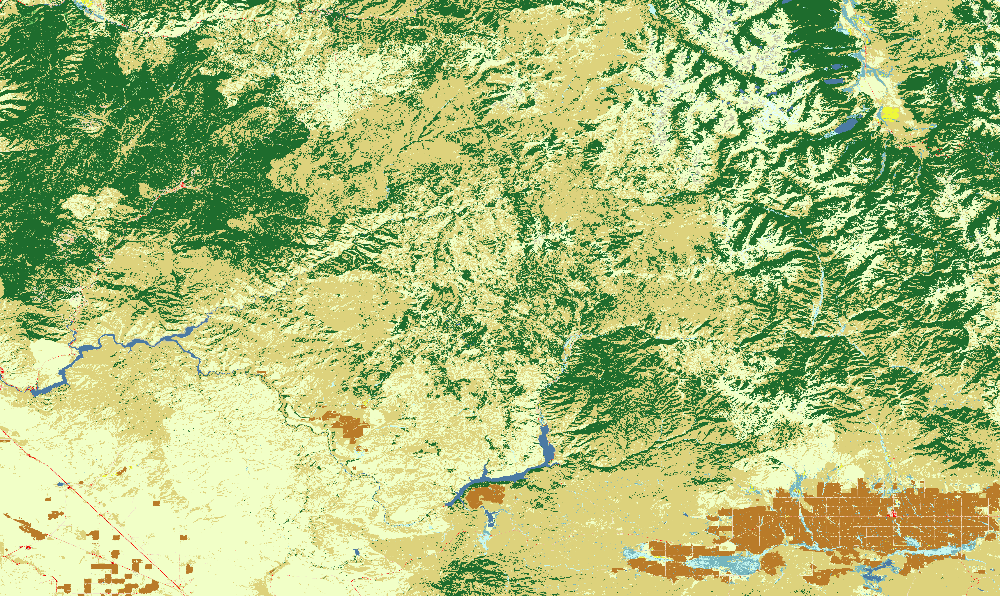

In [5]:
# Simplify hydrography GeoDataFrame. We only need the geometry and reachcode for visualization, and one of the columns
# related to a time stamp was throwing an error when folium tried to parse it.
ubrb_hydrography_simple_gdf = ubrb_hydrography_gdf[['geometry','reachcode']].copy()

# Create folium map centered on the LULC raster
m = folium.Map(location=[rasLat, rasLon], zoom_start=9)

# Add LULC raster as an ImageOverlay
image = folium.raster_layers.ImageOverlay(
    image=ubrb_lulc_array,
    bounds=[[ubrb_lulc.bounds.bottom, ubrb_lulc.bounds.left], 
            [ubrb_lulc.bounds.top, ubrb_lulc.bounds.right]],
    opacity=0.4,
    colormap=lulc_cmap,
    interactive=True,
    cross_origin=False,
)

image.add_to(m)

# Add hydrography GeoDataFrame as a GeoJson overlay
folium.GeoJson(
    ubrb_hydrography_simple_gdf,
    style_function=lambda feature: { # Lambda is like an in-line for loop
        'color': 'blue',
        'weight': 0.2}).add_to(m)

# Add layer control to toggle layers on and off
folium.LayerControl().add_to(m)

# Display the map
m

If you zoom into the map above, you can see some slight misalignments between the river network and the land use/land cover data, which is probably to be expected. We can also, however, see locations where there is a pronounced riparian vegetation effect in the LULC data. 

### 4. Reproject Data

In order to specify the buffer distance in a logical distance unit, we need to use an appropriate Coordinate Reference System (CRS). In this case, we'll use the Universal Transverse Mercator (UTM) projection, zone 13N. For the vector data, this is a fairly straightforward operation – we can just invoke GeoPandas' `.to_crs()` method. For raster datasets it is slightly more complicated, but straightforward. We need to calculate an approprate geometric transformation from one CRS to the other and then apply that transformation to the LULC data to obtain a UTM projected raster. 

In [6]:
ubrb_hydrography_utm_gdf = ubrb_hydrography_gdf.to_crs(epsg=epsg_utm)

In [7]:
# Define the destination CRS for the raster reprojection
dstCrs = {'init': 'EPSG:'+str(epsg_utm)}

# Calculate the transformation parameters and dimensions for the reprojected raster
transform, width, height = calculate_default_transform(
    ubrb_lulc.crs, # Source CRS – geographic (EPSG:4326)
    dstCrs, # Destination CRS – UTM zone 13N (EPSG:32613) as set above
    ubrb_lulc.width, # Width of the source raster
    ubrb_lulc.height, # Height of the source raster
    *ubrb_lulc.bounds # Bounds of the source raster
)

Now we also need to specify some important keywords for the raster reprojection process.

In [8]:
kwargs = ubrb_lulc.meta.copy() # Start with a copy of the original raster metadata
kwargs.update({ # Update the metadata with new values
    'crs': dstCrs, # Destination CRS
    'transform': transform, # Geometric transformation we calculated above
    'width': width, # Width of the reprojected raster
    'height': height # Height of the reprojected raster
})

Finally, we can reproject the LULC raster. Note that this raster only has one band, but the code below is written for a multiband GeoTiff, for which we would need to reproject every band.

In [9]:
ubrb_lulc_utm = rio.open(ubrb_lulc_utm_file, 'w', **kwargs) # Open a new raster file for writing the reprojected data

for i in range(1, ubrb_lulc.count + 1): # Loop over each band in the source raster
    reproject( # Reproject each band
        source=rio.band(ubrb_lulc, i), # Current band from source raster 
        destination=rio.band(ubrb_lulc_utm, i), # Destination band in reprojected raster
        src_transform=ubrb_lulc.transform, # Source raster transform
        src_crs=ubrb_lulc.crs, # Source CRS (geographic)
        dst_transform=transform, # Destination transform we calculated above
        dst_crs=dstCrs, # Destination CRS
        resampling=Resampling.nearest) # Resampling method – nearest neighbor for categorical data
    
ubrb_lulc_utm.close() # Close the reprojected raster file

Now let's open that reprojected raster file and make sure it's in the correct projection.

In [10]:
ubrb_lulc_utm = rio.open(ubrb_lulc_utm_file)
ubrb_lulc_utm_array = ubrb_lulc_utm.read(1)
print(ubrb_lulc_utm.crs)

EPSG:32613


### 5. Select Only Perennial Streams and Buffer 60 m

Now, we want to select only streams in the NHD network that are classified as perennial. Note that when I first did this there were a lot of stream reaches that didn't show up. They tended to be down lower in the watershed, in parts of the river network that would likely be influenced by the tailwater of the reservoirs or be within the reservoirs themselves. So I deduced that these reaches might have been classified as "Artificial Path" because they aren't really perennial streams or intermittent streams, they're just kind of placeholders. Therefore, we create a new vector dataset by selecting only those features in the `fcode_description` attribute that match either `'Stream/River: Hydrographic Category = Perennial'` or `'Artificial Path'`. This leads to a dataset with 8642 records.

In [11]:
ubrb_perennial_utm_gdf = ubrb_hydrography_utm_gdf[(ubrb_hydrography_utm_gdf.fcode_description == 'Stream/River: Hydrographic Category = Perennial')
                                                  | (ubrb_hydrography_utm_gdf.fcode_description == 'Artificial Path')]
ubrb_perennial_utm_gdf

,permanent_identifier,fdate,resolution,gnis_id,gnis_name,lengthkm,reachcode,flowdir,wbarea_permanent_identifier,ftype,...,visibilityfilter,SHAPE_Length,Enabled,resolution_description,flowdir_description,mainpath_description,innetwork_description,visibilityfilter_description,fcode_description,geometry
6,55020671,2012-01-21 22:04:54+00:00,2,00389845,Salix Creek,0.141,17050113001299,1,None,460,...,500000,0.001745,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:500,000 or Larger Scale",Stream/River: Hydrographic Category = Perennial,"LINESTRING Z (-318813.097 4853635.868 0, -3188..."
7,55020677,2012-01-21 22:04:54+00:00,2,00389845,Salix Creek,0.891,17050113001299,1,None,460,...,500000,0.010283,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:500,000 or Larger Scale",Stream/River: Hydrographic Category = Perennial,"LINESTRING Z (-318953.17 4853659.76 0, -319002..."
68,55021433,2012-01-21 22:05:08+00:00,2,None,None,0.017,17050113350700,1,55022157,558,...,100000,0.000207,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:100,000 or Larger Scale",Artificial Path,"LINESTRING Z (-339161.065 4845814.6 0, -339176..."
70,55021367,2012-01-21 22:05:07+00:00,2,None,None,0.593,17050113350685,1,None,460,...,100000,0.006942,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:100,000 or Larger Scale",Stream/River: Hydrographic Category = Perennial,"LINESTRING Z (-336626.914 4847028.458 0, -3366..."
72,55021283,2012-01-21 22:05:05+00:00,2,00393654,Wood Creek,0.016,17050113351576,1,55022137,558,...,100000,0.000196,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:100,000 or Larger Scale",Artificial Path,"LINESTRING Z (-333587.39 4848363.415 0, -33357..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14050,52470607,2012-01-21 21:30:12+00:00,2,00399902,Grimes Creek,0.657,17050112000145,1,None,460,...,2000000,0.007077,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:2,000,000 or Larger Scale",Stream/River: Hydrographic Category = Perennial,"LINESTRING Z (-363481.413 4932673.032 0, -3635..."
14053,52470630,2012-01-21 21:30:12+00:00,2,None,None,1.531,17050112000186,1,None,460,...,24000,0.014394,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:24,000 or Larger Scale",Stream/River: Hydrographic Category = Perennial,"LINESTRING Z (-364826.188 4932152.293 0, -3648..."
14055,52470583,2012-01-21 21:30:12+00:00,2,00399902,Grimes Creek,0.690,17050112000144,1,None,460,...,5000000,0.007325,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:5,000,000 or Larger Scale",Stream/River: Hydrographic Category = Perennial,"LINESTRING Z (-366041.46 4933506.094 0, -36608..."
14056,52470591,2012-01-21 21:30:12+00:00,2,00399902,Grimes Creek,0.742,17050112000145,1,None,460,...,2000000,0.008751,1,High,WithDigitized,Unspecified,Yes,"Approximately 1:2,000,000 or Larger Scale",Stream/River: Hydrographic Category = Perennial,"LINESTRING Z (-363858.075 4933179.641 0, -3638..."


Now we'll buffer the "perennial" line dataset we just created using the GeoPandas `.buffer()` method. Note that the output of this operation is a GeoSeries, which is just a collection of geometries. We promote these to an actual GeoDataFrame using the `gpd.GeoDataFrame()` method. If we wanted to do a table join to add attributes of the stream network (e.g., like the name, etc.), we could just append the columns of `ubrb_perennial_utm_gdf` that we wanted to add as we would in Pandas.

In [12]:
ubrb_perennial_buffer_gdf = gpd.GeoDataFrame(ubrb_perennial_utm_gdf.buffer(60.0))
ubrb_perennial_buffer_gdf

,0
6,"POLYGON ((-318874.137 4853592.486, -318898.892..."
7,"POLYGON ((-319572.697 4853639.744, -319515.228..."
68,"POLYGON ((-339200.947 4845766.55, -339206.22 4..."
70,"POLYGON ((-337098.952 4847053.469, -337088.343..."
72,"POLYGON ((-333548.206 4848411.698, -333542.943..."
...,...
14050,"POLYGON ((-363551.06 4932672.539, -363559.17 4..."
14053,"POLYGON ((-364868.723 4932201.17, -364865.748 ..."
14055,"POLYGON ((-366034.634 4933417.222, -366035.965..."
14056,"POLYGON ((-363910.584 4933140.287, -363916.012..."


### 6. Clip the LULC Raster to the Buffered Dataset

There is no single command for clipping a raster dataset to a polygon in either `Rasterio` or `GeoPandas`. So we have to make use of the `rasterio.mask` library. You can think of this as a set of functions that will crop or mask a raster for each geometric element of the clipping coverage, and then compile all of those masks into a single raster. In truth, this function works with generic geometric units (including things as simple as a rectangle defined explicity by coordinates), not just GeoPandas data frames.    

In [13]:
with rio.open(ubrb_lulc_utm_file) as src: # Open the reprojected LULC raster to clip
    out_image, out_transform = riomask.mask(src, ubrb_perennial_buffer_gdf[0], crop=True) # Mask the raster using the buffered geometries
    out_meta = src.meta.copy() # Copy the metadata from the source raster
    out_meta.update({
        'driver': 'GTiff',
        'height': out_image.shape[1],
        'width': out_image.shape[2],
        'transform': out_transform
    })
    
    with rio.open(ubrb_lulc_riparian_utm_file, 'w', **out_meta) as dest: # Open a new raster file to write the clipped raster
        dest.write(out_image) # Write the clipped raster data to the new file

Now let's open the raster file that represents the LULC within the riparian buffer of perennial streams that we just created using Rasterio.

In [14]:
ubrb_lulc_riparian = rio.open(ubrb_lulc_riparian_utm_file)
ubrb_lulc_riparian_array = ubrb_lulc_riparian.read(1)

### 7. Summarize and Visualize

The first thing we'll do is just create a static plot of the riparian LULC using Matplotlib.

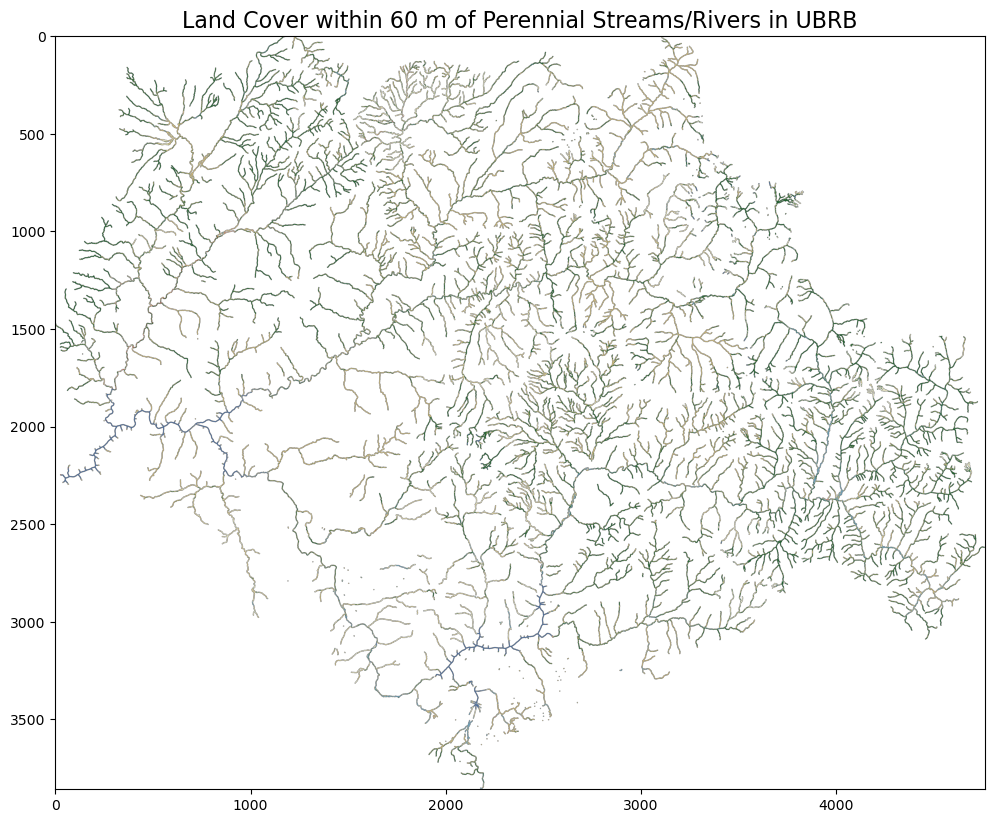

In [15]:
fig, ax = plt.subplots(figsize=(12,12))
ax.imshow(ubrb_lulc_riparian_array, cmap=cmap_nlcd, norm=norm_nlcd)
ax.set_title('Land Cover within 60 m of Perennial Streams/Rivers in UBRB', fontsize=16)
plt.show()

This is fine, and it looks right (?!?), but at this scale it's difficult to see if it's correct. Let's create another interactive web map that allows us to zoom into the riparian LULC and inspect it's actual geography to see if it makes sense.

### 8. Reproject and Make an Interactive Map

We'll again use folium to create our web map. It's important to know, however, that folium can only deal with geographic data that is in a geographic projection or Web Mercator (the projection of the base maps that folium uses). As such, we'll need to project the riparian LULC data back into the original geographic projection of the UBRB LULC that we used in our original web map above. 

In [16]:
dstCrs_geo = {'init': str(ubrb_lulc.crs)} # Set destination CRS to the original geographic CRS from the LULC raster

transform_geo, width_geo, height_geo = calculate_default_transform( # Calculate transform and dimensions for reprojection
    ubrb_lulc_riparian.crs, # Source CRS – UTM zone 13N
    dstCrs_geo, # Destination CRS – original geographic CRS
    ubrb_lulc_riparian.width, # Width of the riparian LULC raster
    ubrb_lulc_riparian.height, # Height of the riparian LULC raster
    *ubrb_lulc_riparian.bounds # Bounds of the riparian LULC raster
)


Again, we need to set the keywords for our reprojection action:

In [17]:
kwargs = ubrb_lulc_riparian.meta.copy() # Start with a copy of the riparian LULC raster metadata
kwargs.update({ # Update the metadata with new values for reprojection
    'crs': dstCrs_geo, # Destination CRS – original geographic CRS
    'transform': transform_geo, # Transform to the geographic CRS we calculated above
    'width': width_geo, # Width in geographic CRS
    'height': height_geo # Height in geographic CRS
})

Now we can proceed to reproject.

In [18]:
ubrb_lulc_riparian_geo = rio.open(ubrb_lulc_riparian_geo_file, 'w', **kwargs) # Open a new raster file for the reprojected riparian LULC

for i in range(1, ubrb_lulc_riparian.count + 1): # Loop over each band in the riparian LULC raster
    reproject(
        source=rio.band(ubrb_lulc_riparian, i), # Source band in UTM
        destination=rio.band(ubrb_lulc_riparian_geo, i), # Destination band in geographic CRS
        src_transform=ubrb_lulc_riparian.transform, # Source transform
        src_crs=ubrb_lulc_riparian.crs, # Source CRS
        dst_transform=transform_geo, # Destination transform calculated above
        dst_crs=dstCrs_geo, # Destination CRS
        resampling=Resampling.nearest) # Resampling method – nearest neighbor for categorical data
    
ubrb_lulc_riparian_geo.close() # Close the reprojected riparian LULC raster file

Again, open the file we just created so we can add it to the web map

In [19]:
ubrb_lulc_riparian_geo = rio.open(ubrb_lulc_riparian_geo_file)
ubrb_lulc_riparian_array = ubrb_lulc_riparian_geo.read(1)

Now create and display an interactive web map

In [20]:
rasLon2 = (ubrb_lulc_riparian_geo.bounds.right + ubrb_lulc_riparian_geo.bounds.left) / 2
rasLat2 = (ubrb_lulc_riparian_geo.bounds.top + ubrb_lulc_riparian_geo.bounds.bottom) / 2


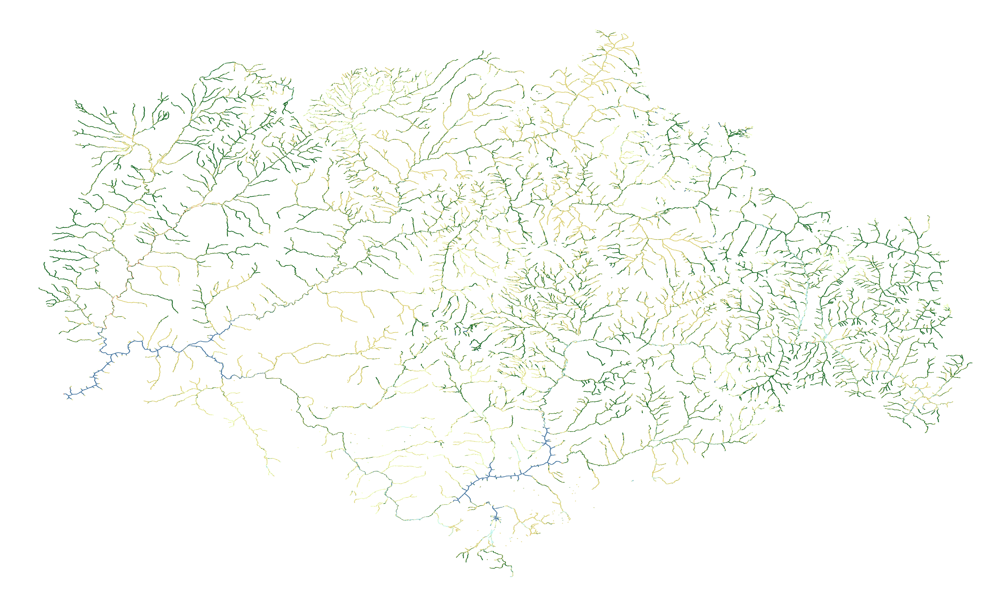

In [21]:
m = folium.Map(location=[rasLat2, rasLon2], zoom_start=9) # Create folium map centered on the riparian LULC raster

# Replace with your desired satellite tile URL
satellite_url = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}'

# Let's add a satellite data layer so we can see the riparian buffer LULC in a visual context
folium.TileLayer(
    tiles=satellite_url,
    attr='Esri Satellite', # Add attribution here
    name='Esri Satellite',
    opacity=0.6
).add_to(m)

image = folium.raster_layers.ImageOverlay( # Add riparian LULC raster as an ImageOverlay
    image=ubrb_lulc_riparian_array,
    bounds=[[ubrb_lulc_riparian_geo.bounds.bottom, ubrb_lulc_riparian_geo.bounds.left],
            [ubrb_lulc_riparian_geo.bounds.top, ubrb_lulc_riparian_geo.bounds.right]],
    opacity=0.8,
    colormap=lulc_cmap, # We're using the same colormap we created above for LULC
    interactive=True,
    cross_origin=False,
)

image.add_to(m) # Add the ImageOverlay to the map

folium.LayerControl().add_to(m) # Add layer control to toggle layers on and off

m # Display the map

This is really cool and allows us to explore the riparian vegetation throughout the UBRB. We can even see places that look like they have significant wetlands.

### 9. Analyze the LULC in the Riparian Area of the UBRB

For the final step, we will use a lot of the code from the beginning of the geospatial unit in which we were classifying LULC within elevation bands in the UBRB. Here we'll perform a histogram of the LULC within the riparian area and then plot as a stacked bar chart.

In [22]:
# Identify the NLCD class codes actually present inside the riparian buffer, ignoring 0, which is the nodata value in this case
lulc_bins = np.unique(ubrb_lulc_riparian_array[(ubrb_lulc_riparian_array > 0)]) 
lulc_1d = ubrb_lulc_riparian_array[ubrb_lulc_riparian_array>0].flatten() # Flatten the array to 1D

lulc_counts = np.zeros(lulc_bins.size) # Pre-allocate storage for the counds

for i in np.arange(lulc_bins.size): # For each LULC category ID, count the number of occurrences within the riparian array
    lulc_counts[i] = np.count_nonzero(lulc_1d == lulc_bins[i])
    
lulc_freq = lulc_counts / np.sum(lulc_counts) # Calculate the frequency 

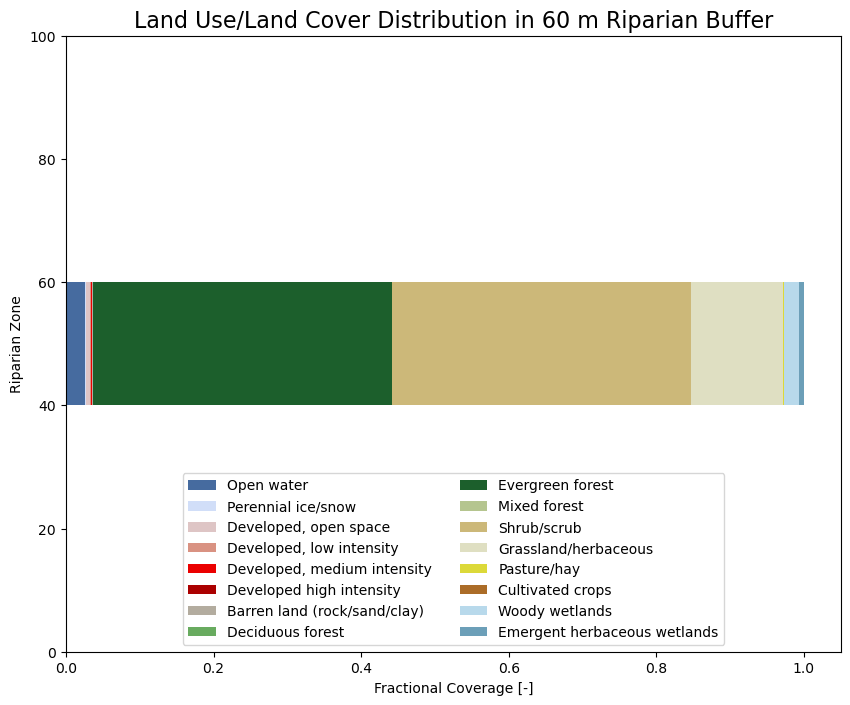

In [23]:
# Associate NLCD codes with labels from the lookup table
nlcd_df = pd.read_csv(nlcd_cfile)

# Stacked horizontal bar emphasizing how the elevation band partitions among NLCD classes
fig, ax = plt.subplots(figsize=(10,8))

left = 0.0

for i in np.arange(lulc_bins.size):
    ax.barh(50, lulc_freq[i], left=left, height=20, color=cmap_nlcd.colors[i+1], label=nlcd_df.label_short.values[i])
    left += lulc_freq[i]

ax.set_ylim([0, 100])
ax.set_title('Land Use/Land Cover Distribution in 60 m Riparian Buffer', fontsize=16)
ax.set_xlabel('Fractional Coverage [-]')
ax.yaxis.set_major_formatter(FormatStrFormatter('%d'))
ax.set_ylabel('Riparian Zone')
ax.legend(fontsize=10, ncol=2, loc='lower center')
plt.show()